In [1]:
import pandas as pd
import numpy as np
import warnings
warnings.filterwarnings("ignore")
import matplotlib.pyplot as plt
import folium
from folium.plugins import HeatMap, MarkerCluster

In [2]:
data = pd.read_csv("/home/vitormuniz/Documentos/data/acidentes/cat_acidentes.csv", sep=";")

In [3]:
data

,data_extracao,predial1,queda_arr,data,feridos,feridos_gr,mortes,morte_post,fatais,auto,...,longitude,latitude,log1,log2,tipo_acid,dia_sem,hora,noite_dia,regiao,consorcio
0,2025-09-01 01:33:25,0.0,0.0,2020-10-17 00:00:00,1,0,0,0,0,3,...,0.000000,0.000000,R MARCOS MOREIRA,R GASTON ENGLERT,ABALROAMENTO,SÁBADO,19:00:00.0000000,NOITE,NORTE,NaN
1,2025-09-01 01:33:25,598.0,0.0,2020-01-01 00:00:00,1,0,0,0,0,0,...,NaN,NaN,AV BENTO GONCALVES,NaN,ABALROAMENTO,QUARTA-FEIRA,03:00:00.0000000,NOITE,LESTE,NaN
2,2025-09-01 01:33:25,1271.0,0.0,2020-01-01 00:00:00,1,1,0,0,0,1,...,NaN,NaN,AV INDEPENDENCIA,NaN,ATROPELAMENTO,QUARTA-FEIRA,23:00:00.0000000,NOITE,LESTE,NaN
3,2025-09-01 01:33:25,1901.0,0.0,2020-01-02 00:00:00,2,0,0,0,0,0,...,NaN,NaN,AV EDUARDO PRADO,NaN,ATROPELAMENTO,QUINTA-FEIRA,00:05:00.0000000,NOITE,SUL,NaN
4,2025-09-01 01:33:25,3302.0,0.0,2020-01-02 00:00:00,1,0,0,0,0,1,...,-51.211535,-30.081535,AV TERESOPOLIS,NaN,ABALROAMENTO,QUINTA-FEIRA,09:00:00.0000000,DIA,SUL,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
75171,2025-09-01 01:33:25,680.0,0.0,2025-07-03 00:00:00,0,0,0,0,0,2,...,-51.213184,-30.049725,AV AZENHA,NaN,COLISÃO,QUINTA-FEIRA,16:30:00.0000000,DIA,LESTE,NaN
75172,2025-09-01 01:33:25,421.0,0.0,2025-07-03 00:00:00,0,0,0,0,0,1,...,-51.204159,-30.033800,R CABRAL,R MARIANTE,COLISÃO,QUINTA-FEIRA,18:15:00.0000000,NOITE,LESTE,NaN
75173,2025-09-01 01:33:25,1024.0,0.0,2025-07-07 00:00:00,0,0,0,0,0,1,...,-51.248341,-30.099139,AV WENCESLAU ESCOBAR,NaN,COLISÃO,SEGUNDA-FEIRA,09:10:00.0000000,DIA,SUL,NaN
75174,2025-09-01 01:33:25,1039.0,0.0,2025-07-07 00:00:00,0,0,0,0,0,1,...,-51.230281,-30.093377,R SANTA FLORA,NaN,COLISÃO,SEGUNDA-FEIRA,13:35:00.0000000,DIA,SUL,NaN


In [4]:
data.isnull().sum()

data_extracao        0
predial1          4461
queda_arr            0
data                 0
feridos              0
feridos_gr           0
mortes               0
morte_post           0
fatais               0
auto                 0
taxi                 0
lotacao              0
onibus_urb           0
onibus_met           0
onibus_int           0
caminhao             0
moto                 0
carroca              0
bicicleta            0
outro                0
cont_vit             0
ups                  0
patinete             0
idacidente           0
longitude        10596
latitude         10596
log1                53
log2             54523
tipo_acid            0
dia_sem              0
hora               629
noite_dia            0
regiao               1
consorcio        72766
dtype: int64

ETL Latitude e Longitude

In [5]:
mapa_rua_log1 = (
    data
    .dropna(subset=["log1", "latitude", "longitude"])
    .drop_duplicates(subset=["log1"])
    .set_index("log1")[["latitude", "longitude"]]
)

# Preenche latitude e longitude onde estão nulas
mask = data["latitude"].isna() | data["longitude"].isna()

data.loc[mask, "latitude"] = data.loc[mask, "log1"].map(mapa_rua_log1["latitude"])
data.loc[mask, "longitude"] = data.loc[mask, "log1"].map(mapa_rua_log1["longitude"])


In [6]:
mapa_rua_log2 = (
    data
    .dropna(subset=["log2", "latitude", "longitude"])
    .drop_duplicates(subset=["log2"])
    .set_index("log2")[["latitude", "longitude"]]
)

# Preenche latitude e longitude onde estão nulas
mask = data["latitude"].isna() | data["longitude"].isna()

data.loc[mask, "latitude"] = data.loc[mask, "log1"].map(mapa_rua_log2["latitude"])
data.loc[mask, "longitude"] = data.loc[mask, "log1"].map(mapa_rua_log2["longitude"])

In [7]:
data.isnull().sum()

data_extracao        0
predial1          4461
queda_arr            0
data                 0
feridos              0
feridos_gr           0
mortes               0
morte_post           0
fatais               0
auto                 0
taxi                 0
lotacao              0
onibus_urb           0
onibus_met           0
onibus_int           0
caminhao             0
moto                 0
carroca              0
bicicleta            0
outro                0
cont_vit             0
ups                  0
patinete             0
idacidente           0
longitude          391
latitude           391
log1                53
log2             54523
tipo_acid            0
dia_sem              0
hora               629
noite_dia            0
regiao               1
consorcio        72766
dtype: int64

In [8]:
data = data.dropna(subset=["latitude", "longitude"])

In [9]:
mapa = folium.Map(location=[-30.10, -51.15], zoom_start=10)
cordenadas = list(zip(data.latitude, data.longitude))
mapa_calor = HeatMap(cordenadas, radius=9, blur=10)
mapa.add_child(mapa_calor)

In [10]:
mapa = folium.Map(location=[-30.10, -51.15], zoom_start=10)
cordenadas = list(zip(data.latitude, data.longitude))
mapa_cluster = MarkerCluster(cordenadas)
mapa.add_child(mapa_cluster)

Fazendo análises de acidentes por horários e datas

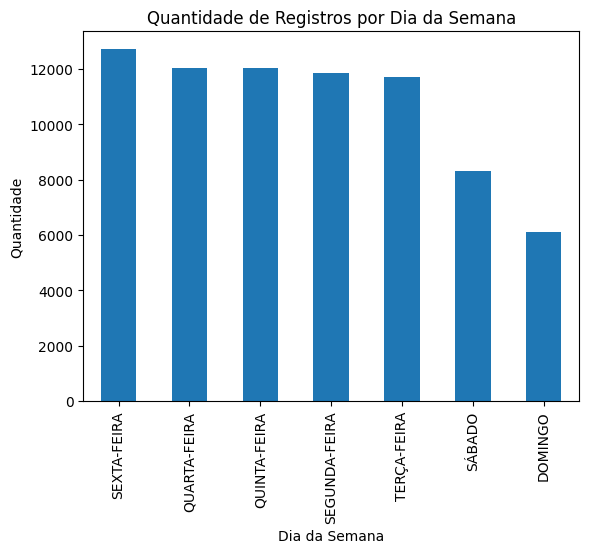

In [11]:
# Contar ocorrências
contagem_dia_sem = data['dia_sem'].value_counts()

# Plotar
contagem_dia_sem.plot(kind='bar')
plt.title('Quantidade de Registros por Dia da Semana')
plt.xlabel('Dia da Semana')
plt.ylabel('Quantidade')

plt.show()

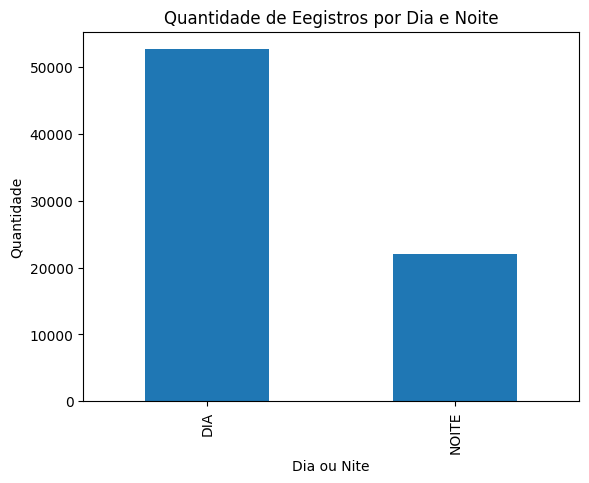

In [12]:
# Contar ocorrências
contagem_dia_sem = data['noite_dia'].value_counts()

# Plotar o gráfico
contagem_dia_sem.plot(kind='bar')
plt.title('Quantidade de Eegistros por Dia e Noite')
plt.xlabel('Dia ou Nite')
plt.ylabel('Quantidade')

plt.show()

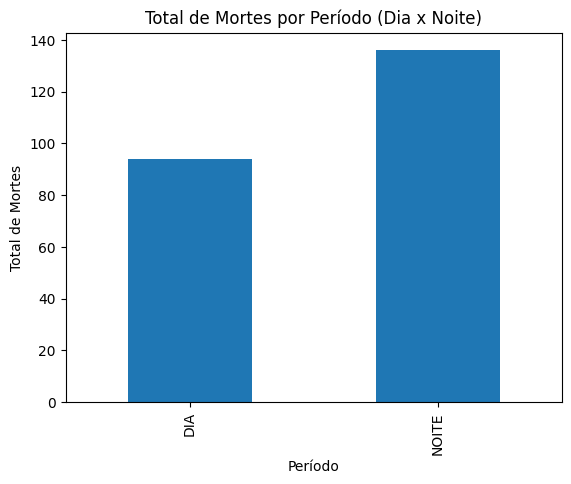

In [ ]:
soma_mortes = (data.groupby('noite_dia')['mortes'].sum())

soma_mortes.plot(kind='bar')
plt.title('Total de Mortes por Período (Dia x Noite)')
plt.xlabel('Período')
plt.ylabel('Total de Mortes')

plt.show()

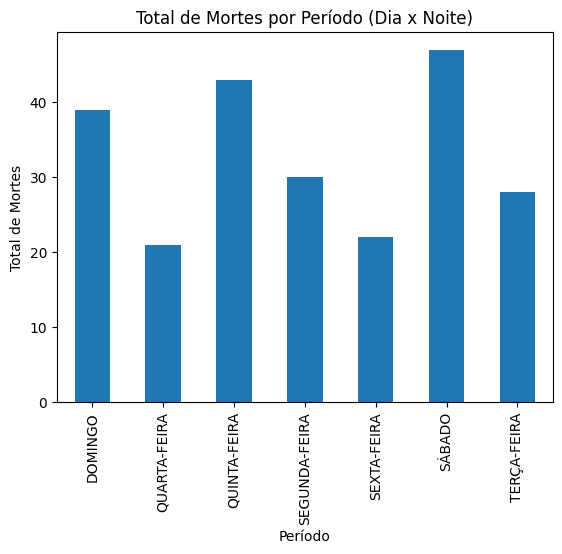

In [16]:
soma_mortes_dia_sem = (data.groupby('dia_sem')['mortes'].sum())

soma_mortes_dia_sem.plot(kind='bar')
plt.title('Total de Mortes por Período (Dia x Noite)')
plt.xlabel('Período')
plt.ylabel('Total de Mortes')

plt.show()

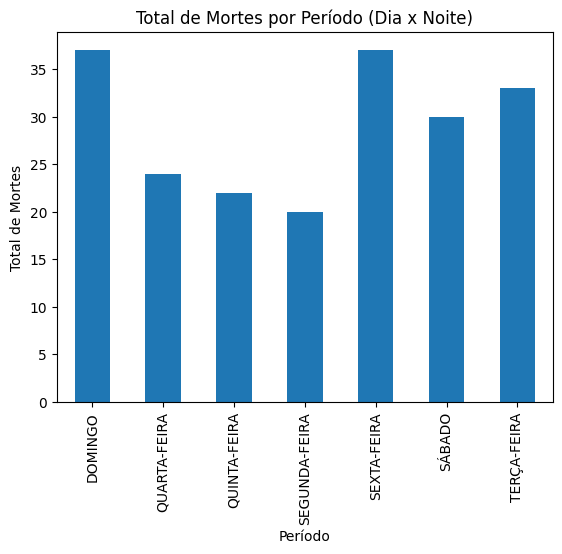

In [17]:
soma_mortes_dia_sem = (data.groupby('dia_sem')['morte_post'].sum())

soma_mortes_dia_sem.plot(kind='bar')
plt.title('Total de Mortes por Período (Dia x Noite)')
plt.xlabel('Período')
plt.ylabel('Total de Mortes')

plt.show()